In [198]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
from PIL import Image

In [569]:
csv_path = './save_mask12.csv'

In [570]:
df = pd.read_csv(csv_path)

In [571]:
#여기 위에 검들면 아노딤

In [572]:
print(df)

       Unnamed: 0  Unnamed: 0.1  Unnamed: 0.1.1  \
0               0             0               0   
1               1             1               1   
2               2             2               2   
3               3             3               3   
4               4             4               4   
...           ...           ...             ...   
18895       18895         18895           18895   
18896       18896         18896           18896   
18897       18897         18897           18897   
18898       18898         18898           18898   
18899       18899         18899           18899   

                                                    path  mask  gender  age  \
0      /opt/ml/input/data/train/images_segmented/0032...     1       1    0   
1      /opt/ml/input/data/train/images_segmented/0032...     0       1    0   
2      /opt/ml/input/data/train/images_segmented/0032...     0       1    0   
3      /opt/ml/input/data/train/images_segmented/0032...     2       1 

In [573]:
target = df[df['mask'] == 0]

In [574]:
def modify(id, col, error_type, value):
    df.loc[df.id==id, (col, error_type)] = (value, True)

In [575]:
NUM_ROW = 100
NUM_COL = 5
TOTAL = NUM_ROW * NUM_COL
# TOTAL = 204
start_idx = 0

In [576]:
def myplot():
    plt.figure(figsize=(20,400))

    global start_idx
    cnt = 1
    for idx in range(start_idx, start_idx + TOTAL):
        img = Image.open(target.iloc[idx].path)
        plt.subplot(NUM_ROW, NUM_COL, cnt)
        plt.imshow(img)
        plt.title(target.iloc[idx].id)
        plt.axis('off')
        cnt+=1

    plt.show()
    start_idx += TOTAL
    print(f'{start_idx} / {len(target)}')

In [577]:
col = 'mask'
error_type = 'mask_error'

In [561]:
id = 14075
modify(id, col, error_type, 0) # value wear=0, incorret=1, no_mask=2

In [584]:
df.iloc[6].path

'/opt/ml/input/data/train/images_segmented/003245_female_Asian_19/mask5.jpg'

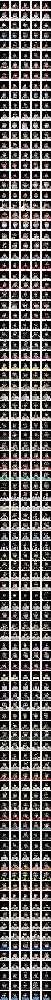

1000 / 13502


In [585]:
myplot()

In [568]:
df.to_csv('~/util/save_mask12.csv')